## Sentiment Analysis on Tweets

### **1. Import Required Libraries**

In [56]:
# pip install numpy pandas matplotlib seaborn scikit-learn nltk
import numpy as np
import pandas as pd
import re
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('omw-1.4')  # Optional, but helps with some text processing

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\casso\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\casso\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\casso\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

### **2. Load and Preprocess the Dataset**

In [57]:
df = pd.read_csv("https://raw.githubusercontent.com/dD2405/Twitter_Sentiment_Analysis/master/train.csv")

# Rename columns for clarity
df = df[['tweet', 'label']]
df.columns = ['text', 'sentiment']

# Map sentiment labels (0 = Negative, 1 = Neutral, 2 = Positive)
df['sentiment'] = df['sentiment'].map({0: 'negative', 1: 'neutral', 2: 'positive'})


### **3. Visualizing Sentiment Distribution**

C:\Users\casso\AppData\Local\Temp\ipykernel_22428\4267238931.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=df['sentiment'], palette="coolwarm")


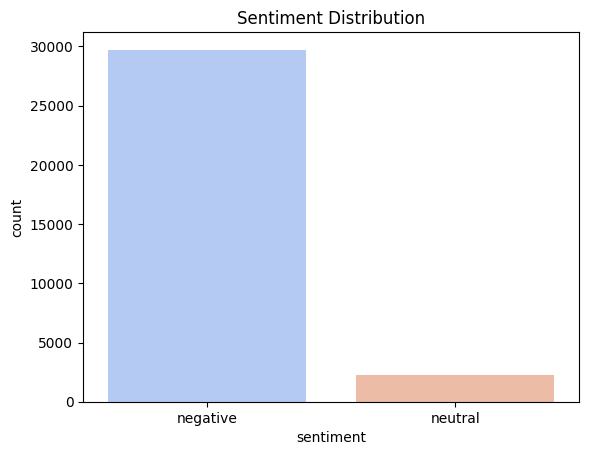

In [58]:
sns.countplot(x=df['sentiment'], palette="coolwarm")
plt.title("Sentiment Distribution")
plt.show()

### **4. Text Preprocessing**

In [59]:

def preprocess_text(text):
    try:
        if not isinstance(text, str) or text.strip() == "":
            return "emptytext"  # Prevent empty strings
        
        text = text.lower()  
        text = re.sub(r"http\S+|www\S+|https\S+", "", text)  
        text = re.sub(r"@\w+|#", "", text)  
        text = re.sub(r"[^\w\s]", "", text)  
        text = re.sub(r"\d+", "", text)  
        text = word_tokenize(text)  
        text = [word for word in text if word not in stopwords.words('english')]  

        return " ".join(text) if text else "emptytext"  # Prevent empty output

    except Exception as e:
        print(f"Error processing text: {text} - {str(e)}")
        return "emptytext"  # Handle failures gracefully


# Apply function to DataFrame
df['clean_text'] = df['text'].apply(preprocess_text)

print(df[['text', 'clean_text']])

Error processing text:   when a father is dysfunctional and is so selfish he drags his kids into his dysfunction   run - 
**********************************************************************
  Resource punkt_tab not found.
  Please use the NLTK Downloader to obtain the resource:

  >>> import nltk
  >>> nltk.download('punkt_tab')
  
  For more information see: https://www.nltk.org/data.html

  Attempted to load tokenizers/punkt_tab/english/

  Searched in:
    - 'C:\\Users\\casso/nltk_data'
    - 'c:\\Python312\\nltk_data'
    - 'c:\\Python312\\share\\nltk_data'
    - 'c:\\Python312\\lib\\nltk_data'
    - 'C:\\Users\\casso\\AppData\\Roaming\\nltk_data'
    - 'C:\\nltk_data'
    - 'D:\\nltk_data'
    - 'E:\\nltk_data'
**********************************************************************

Error processing text:   thanks for lyft credit i cant use cause they dont offer wheelchair vans in pdx    disapointed getthanked - 
******************************************************************

### **5. Split Data into Train & Test Sets**

In [60]:
X_train, X_test, y_train, y_test = train_test_split(df[['clean_text']], df['sentiment'], test_size=0.2, random_state=42)


### **6. Convert Text to TF-IDF Vectors**

In [61]:
X_train.dropna(subset=['clean_text'], inplace=True)
X_test.dropna(subset=['clean_text'], inplace=True)

# Replace empty rows with a placeholder
X_train['clean_text'].replace("", "emptytext", inplace=True)
X_test['clean_text'].replace("", "emptytext", inplace=True)

vectorizer = TfidfVectorizer(max_features=5000)
X_train_tfidf = vectorizer.fit_transform(X_train['clean_text'])
X_test_tfidf = vectorizer.transform(X_test['clean_text'])


C:\Users\casso\AppData\Local\Temp\ipykernel_22428\3555020199.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_train['clean_text'].replace("", "emptytext", inplace=True)
C:\Users\casso\AppData\Local\Temp\ipykernel_22428\3555020199.py:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a co

### **7. Train Logistic Regression Model**

In [62]:
log_model = LogisticRegression()
log_model.fit(X_train_tfidf, y_train)

LogisticRegression()

### **8. Train Naive Bayes Model**

In [63]:
nb_model = MultinomialNB()
nb_model.fit(X_train_tfidf, y_train)

MultinomialNB()


### **9. Make Predictions on Test Data**

In [64]:
log_preds = log_model.predict(X_test_tfidf)
nb_preds = nb_model.predict(X_test_tfidf)

### **10. Evaluate Model Performance**

In [65]:
log_acc = accuracy_score(y_test, log_preds)
nb_acc = accuracy_score(y_test, nb_preds)

print(f"\n✅ Logistic Regression Accuracy: {log_acc:.4f}")
print(f"✅ Naive Bayes Accuracy: {nb_acc:.4f}")


✅ Logistic Regression Accuracy: 0.9287
✅ Naive Bayes Accuracy: 0.9287


### **11. Display Classification Reports**

In [66]:
print("\n🔹 Logistic Regression Performance:")
print(classification_report(y_test, log_preds))

print("\n🔹 Naive Bayes Performance:")
print(classification_report(y_test, nb_preds))


🔹 Logistic Regression Performance:
              precision    recall  f1-score   support

    negative       0.93      1.00      0.96      5937
     neutral       0.00      0.00      0.00       456

    accuracy                           0.93      6393
   macro avg       0.46      0.50      0.48      6393
weighted avg       0.86      0.93      0.89      6393


🔹 Naive Bayes Performance:
              precision    recall  f1-score   support

    negative       0.93      1.00      0.96      5937
     neutral       0.00      0.00      0.00       456

    accuracy                           0.93      6393
   macro avg       0.46      0.50      0.48      6393
weighted avg       0.86      0.93      0.89      6393



c:\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1565: Unde

### **12. Confusion Matrix for Logistic Regression**

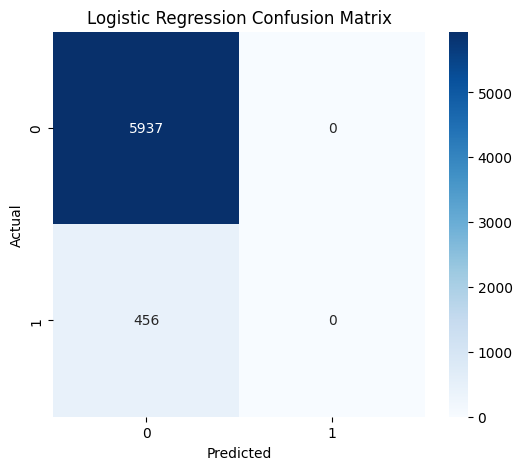

In [67]:
plt.figure(figsize=(6,5))
sns.heatmap(confusion_matrix(y_test, log_preds), annot=True, fmt="d", cmap="Blues")
plt.title("Logistic Regression Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()